In [120]:
import os
import sys

import geopandas as gpd
from geodatasets import get_path

import numpy as np  # No olvides esta línea

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.colors as mcolors

import pandas as pd
import requests
import matplotlib_scalebar
from matplotlib_scalebar.scalebar import ScaleBar

from shapely.geometry import Point


## Archivos con datos geograficos:

mx = division politica municipal


In [15]:
#Municipios
mx = gpd.read_file('mapa_mexico/')\
        .set_index('CLAVE')\
        .to_crs(epsg=4485)

,NOM_MUN,NOMEDO,CVE_EDO,CVE_MUNI,Area,geometry
CLAVE,,,,,,
02004,Tijuana,Baja California,02,004,1122.661145,"POLYGON ((-73565.018 3602427.487, -73564.403 3..."
02003,Tecate,Baja California,02,003,3670.991923,"POLYGON ((-38995.078 3617846.589, -31557.921 3..."
02002,Mexicali,Baja California,02,002,13119.275713,"POLYGON ((48160.716 3621731.593, 58570.990 362..."
02005,Playas de Rosarito,Baja California,02,005,517.120801,"POLYGON ((-70946.724 3594803.753, -70966.034 3..."
26055,San Luis Rio Colorado,Sonora,26,055,9033.770278,"POLYGON ((127160.493 3587762.823, 127099.688 3..."


In [ ]:
mx.head()

In [16]:
#Estados
mx1 = gpd.read_file('dest22gw_c/')
#        .set_index('CLAVE')\
#        .to_crs(epsg=4485)

In [61]:
mx1.head(33)

,CVEGEO,NOMGEO,NOM_ENT,CVE_CAP,NOM_CAP,COV_,COV_ID,AREA,PERIMETER,geometry
0,01,Aguascalientes,Aguascalientes,10001,Aguascalientes,0,1,5.558674e+05,4.230060e+05,"POLYGON ((2514208.499 1112307.424, 2514208.401..."
1,02,Baja California,Baja California,20001,Mexicali,1,2,7.341220e+06,3.114718e+06,"MULTIPOLYGON (((1311406.345 1822297.206, 13114..."
2,03,Baja California Sur,Baja California Sur,30001,La Paz,2,3,7.277398e+06,4.086628e+06,"MULTIPOLYGON (((1693077.433 1228243.697, 16930..."
3,04,Campeche,Campeche,20001,San Francisco de Campeche,3,4,5.726983e+06,1.566405e+06,"MULTIPOLYGON (((3602315.669 739693.455, 360220..."
4,05,Coahuila de Zaragoza,Coahuila de Zaragoza,300001,Saltillo,4,5,1.506712e+07,2.414885e+06,"POLYGON ((2712006.138 1746811.831, 2710748.119..."
5,06,Colima,Colima,20001,Colima,5,6,5.754123e+05,6.436262e+05,"MULTIPOLYGON (((2317041.268 744520.209, 231702..."
6,07,Chiapas,Chiapas,1010001,Tuxtla GutiÃ©rrez,6,7,7.361736e+06,1.779551e+06,"MULTIPOLYGON (((3535499.308 339566.394, 353552..."
7,08,Chihuahua,Chihuahua,190001,Chihuahua,7,8,2.469734e+07,3.120466e+06,"POLYGON ((2372702.661 1882235.303, 2372695.925..."
8,09,Ciudad de MÃ©xico,Ciudad de MÃ©xico,0,NaN,8,9,1.486183e+05,2.068763e+05,"POLYGON ((2817139.495 789859.733, 2816778.870 ..."
9,10,Durango,Durango,50001,Victoria de Durango,9,10,1.221312e+07,2.500704e+06,"POLYGON ((2331613.993 1630852.462, 2333301.200..."


## Bases de datos

#### Insituciones

In [25]:
#Puntos con las instituciones de atencion al migrante irregular en transito recopiladas
inst = pd.read_csv('/Users/pablouriarte/Documents/1. Expediente Tec de Monterrey/1.Tesis/Mapa_Migracion_Irregular_Mexico/institucionesmigracionfullfinal.csv', encoding='utf-8')


In [28]:
# Convierte el DataFrame a un GeoDataFrame
gdfinst = gpd.GeoDataFrame(inst, geometry=gpd.points_from_xy(inst.longitud, inst.latitud))


In [40]:
# Reproyectar gdf para que coincida con mx1
gdfinst = gdfinst.to_crs(mx1.crs)

In [41]:
gdfinst.head()

,name,descripcion,latitud,longitud,coordenadas,tipo,direccion,bd,geometry
0,DIF Estatal Baja California,DIF,32.663780,-115.464355,"32.6637802, -115.464355",GOB,"Av. Obregón 1290, Col. Nueva 2da. Secc., C.P. ...",Directorio OIM,POINT (1229325.426 2348375.101)
1,Ángeles Sin Fronteras,Centros de Atención Social,32.662937,-115.494983,"32.66293697601438, -115.49498343917332",OSC / ONG,"Av. Reforma 244, Altos Zona Centro C.P.21100",Directorio OIM,POINT (1226434.599 2348552.973)
2,Centro de Apoyo al Trabajor Migrante,Centros de Atención Social,32.660848,-115.479494,"32.660847720110326, -115.4794934911816",OSC / ONG,"Jabonera 6, Col. Nueva C.P. 21100",Directorio OIM,POINT (1227870.214 2348183.094)
3,Centro de Apoyo al Trabajador Migrante: Comit...,Centros de Atención Social,32.660305,-115.459726,"32.6603047, -115.4597261",OSC / ONG,"Calle Jabonera #6, Colonia Nueva, Mexicali, Ba...",redes,POINT (1229724.596 2347947.480)
4,Comedor Cobina A.C.,Centros de Atención Social,32.660301,-115.489875,"32.66030066068713, -115.48987485285113",OSC / ONG,"Avenida Lerdo 416, Col. Centro C.P. 21200",Directorio OIM,POINT (1226887.616 2348214.358)


In [46]:
# Obtener los valores únicos de la columna "descripcion"
unique_descripcion = gdfinst['descripcion'].unique().tolist()

# Obtener los valores únicos de la columna "tipo"
unique_tipo = gdfinst['tipo'].unique().tolist()

print("Valores únicos en 'descripcion':", unique_descripcion)
print()
print("Valores únicos en 'tipo':", unique_tipo)

Valores únicos en 'descripcion': ['DIF', 'Centros de Atención Social', 'Grupos Beta', 'Mujeres', 'Oficina Consular', 'CNDH', 'INM', 'Oficinas de Atención a Migrante', 'Salud', 'FISCALÍAS ESPECIALIZADAS PARA PERSONAS MIGRANTES', 'COMAR', 'SEMIGRANTE', 'ONU', 'Consulados']

Valores únicos en 'tipo': ['GOB', 'OSC / ONG']


In [52]:
##Diccionario para distinciones de categorias

# Crear un diccionario para asignar colores a cada 'tipo'
color_dict = {'GOB': 'blue', 'OSC / ONG': 'red'}

# Crear un diccionario para asignar formas de marcador a cada 'descripcion'
marker_dict = {
    'DIF': 'o',
    'Centros de Atención Social': 's',
    'Grupos Beta': '^',
    'Mujeres': 'v',
    'Oficina Consular': '<',
    'CNDH': '>',
    'INM': 'D',
    'Oficinas de Atención a Migrante': 'd',
    'Salud': '*',
    'FISCALÍAS ESPECIALIZADAS PARA PERSONAS MIGRANTES': 'p',
    'COMAR': 'h',
    'SEMIGRANTE': '+',
    'ONU': 'x',
    'Consulados': '|'
}


### Datos ( Mapa Coropletico)

Todos los datos con reportes de incidencias en formato de conteo para realizar heatmaps

####  3.1 Eventos de personas en situación migratoria irregular en México, según entidad federativa, 2022


In [126]:
# 3.1 Eventos de personas en situación migratoria irregular en México, según entidad federativa, 2022
df1 = pd.read_excel('/Users/pablouriarte/Documents/1. Expediente Tec de Monterrey/1.Tesis/Mapa_Migracion_Irregular_Mexico/datos/cuadro3.1_.xls')


In [127]:
df1.head(50)

,Entidad federativa,CVEGEO,COV_ID,Presentados,Canalizados,Total
0,Aguascalientes,1,1,956,137,1093
1,Baja California,2,2,20 401,24040,44441
2,Baja California Sur,3,3,120,3,123
3,Campeche,4,4,804,504,1308
4,Chiapas,5,7,103 487,48982,152469
5,Chihuahua,6,8,10 796,3301,14097
6,Coahuila,7,5,28 287,6386,34673
7,Colima,8,6,5,0,5
8,Ciudad de México,9,9,4 356,1379,5735
9,Durango,10,10,1 209,394,1603


In [128]:
mx1datosdf1 = mx1

In [125]:
mx1.head(32)

,CVEGEO,NOMGEO,NOM_ENT,CVE_CAP,NOM_CAP,COV_,COV_ID,AREA,PERIMETER,geometry
0,01,Aguascalientes,Aguascalientes,10001,Aguascalientes,0,1,5.558674e+05,4.230060e+05,"POLYGON ((2514208.499 1112307.424, 2514208.401..."
1,02,Baja California,Baja California,20001,Mexicali,1,2,7.341220e+06,3.114718e+06,"MULTIPOLYGON (((1311406.345 1822297.206, 13114..."
2,03,Baja California Sur,Baja California Sur,30001,La Paz,2,3,7.277398e+06,4.086628e+06,"MULTIPOLYGON (((1693077.433 1228243.697, 16930..."
3,04,Campeche,Campeche,20001,San Francisco de Campeche,3,4,5.726983e+06,1.566405e+06,"MULTIPOLYGON (((3602315.669 739693.455, 360220..."
4,05,Coahuila de Zaragoza,Coahuila de Zaragoza,300001,Saltillo,4,5,1.506712e+07,2.414885e+06,"POLYGON ((2712006.138 1746811.831, 2710748.119..."
5,06,Colima,Colima,20001,Colima,5,6,5.754123e+05,6.436262e+05,"MULTIPOLYGON (((2317041.268 744520.209, 231702..."
6,07,Chiapas,Chiapas,1010001,Tuxtla GutiÃ©rrez,6,7,7.361736e+06,1.779551e+06,"MULTIPOLYGON (((3535499.308 339566.394, 353552..."
7,08,Chihuahua,Chihuahua,190001,Chihuahua,7,8,2.469734e+07,3.120466e+06,"POLYGON ((2372702.661 1882235.303, 2372695.925..."
8,09,Ciudad de MÃ©xico,Ciudad de MÃ©xico,0,NaN,8,9,1.486183e+05,2.068763e+05,"POLYGON ((2817139.495 789859.733, 2816778.870 ..."
9,10,Durango,Durango,50001,Victoria de Durango,9,10,1.221312e+07,2.500704e+06,"POLYGON ((2331613.993 1630852.462, 2333301.200..."


In [129]:
# Selecciona las columnas específicas que deseas unir de 'df1'
selected_columns = df1[['COV_ID', 'Entidad federativa', 'Presentados', 'Canalizados', 'Total']]

# Realiza la unión con 'mx1datosdf1' usando la columna 'COV_ID'
merged_df = pd.merge(mx1datosdf1, selected_columns, on='COV_ID', how='left')  # Puedes cambiar 'left' por otro método si lo prefieres


In [130]:
merged_df.head(32)

,CVEGEO,NOMGEO,NOM_ENT,CVE_CAP,NOM_CAP,COV_,COV_ID,AREA,PERIMETER,geometry,Entidad federativa,Presentados,Canalizados,Total
0,01,Aguascalientes,Aguascalientes,10001,Aguascalientes,0,1,5.558674e+05,4.230060e+05,"POLYGON ((2514208.499 1112307.424, 2514208.401...",Aguascalientes,956,137,1093
1,02,Baja California,Baja California,20001,Mexicali,1,2,7.341220e+06,3.114718e+06,"MULTIPOLYGON (((1311406.345 1822297.206, 13114...",Baja California,20 401,24040,44441
2,03,Baja California Sur,Baja California Sur,30001,La Paz,2,3,7.277398e+06,4.086628e+06,"MULTIPOLYGON (((1693077.433 1228243.697, 16930...",Baja California Sur,120,3,123
3,04,Campeche,Campeche,20001,San Francisco de Campeche,3,4,5.726983e+06,1.566405e+06,"MULTIPOLYGON (((3602315.669 739693.455, 360220...",Campeche,804,504,1308
4,05,Coahuila de Zaragoza,Coahuila de Zaragoza,300001,Saltillo,4,5,1.506712e+07,2.414885e+06,"POLYGON ((2712006.138 1746811.831, 2710748.119...",Coahuila,28 287,6386,34673
5,06,Colima,Colima,20001,Colima,5,6,5.754123e+05,6.436262e+05,"MULTIPOLYGON (((2317041.268 744520.209, 231702...",Colima,5,0,5
6,07,Chiapas,Chiapas,1010001,Tuxtla GutiÃ©rrez,6,7,7.361736e+06,1.779551e+06,"MULTIPOLYGON (((3535499.308 339566.394, 353552...",Chiapas,103 487,48982,152469
7,08,Chihuahua,Chihuahua,190001,Chihuahua,7,8,2.469734e+07,3.120466e+06,"POLYGON ((2372702.661 1882235.303, 2372695.925...",Chihuahua,10 796,3301,14097
8,09,Ciudad de MÃ©xico,Ciudad de MÃ©xico,0,NaN,8,9,1.486183e+05,2.068763e+05,"POLYGON ((2817139.495 789859.733, 2816778.870 ...",Ciudad de México,4 356,1379,5735
9,10,Durango,Durango,50001,Victoria de Durango,9,10,1.221312e+07,2.500704e+06,"POLYGON ((2331613.993 1630852.462, 2333301.200...",Durango,1 209,394,1603


In [143]:
# Definir los bins para eventos de migrantes en transito irregular
binsemti = [0, 1000, 5000, 15000, 25000, 50000, 100000, np.inf]
labelsemti = ['0-1k', '1k-5k', '5k-15k', '15k-25k', '25k-50k', '50k-100k', '100k+']

# Crear una nueva columna para los bins
merged_df['Total_bins'] = pd.cut(merged_df['Total'], bins=binsemti, labels=labelsemti, right=False)

#### otra...

#### Rutas

### Mapas Simples

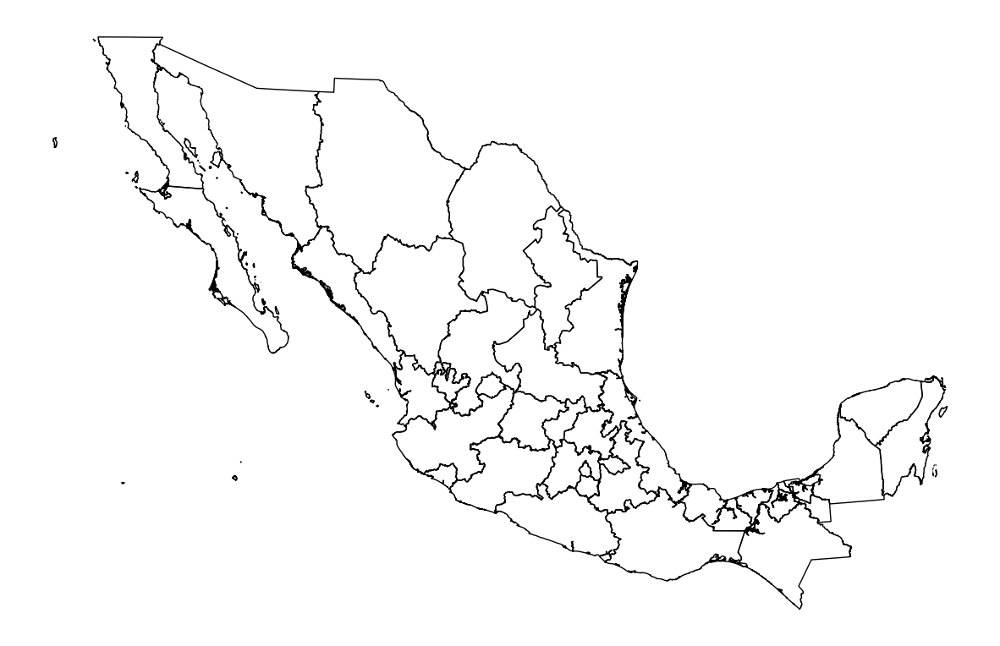

In [13]:
# Trazar el mapa en blanco con solo los polígonos de los estados
fig, ax = plt.subplots(figsize=(15, 15))  # Especifica un tamaño de figura más grande
mx1.boundary.plot(ax=ax, linewidth=1, color='black')  # Dibuja solo los límites de los polígonos
ax.set_axis_off()  # Desactiva los ejes para un mapa en "blanco"

plt.show()

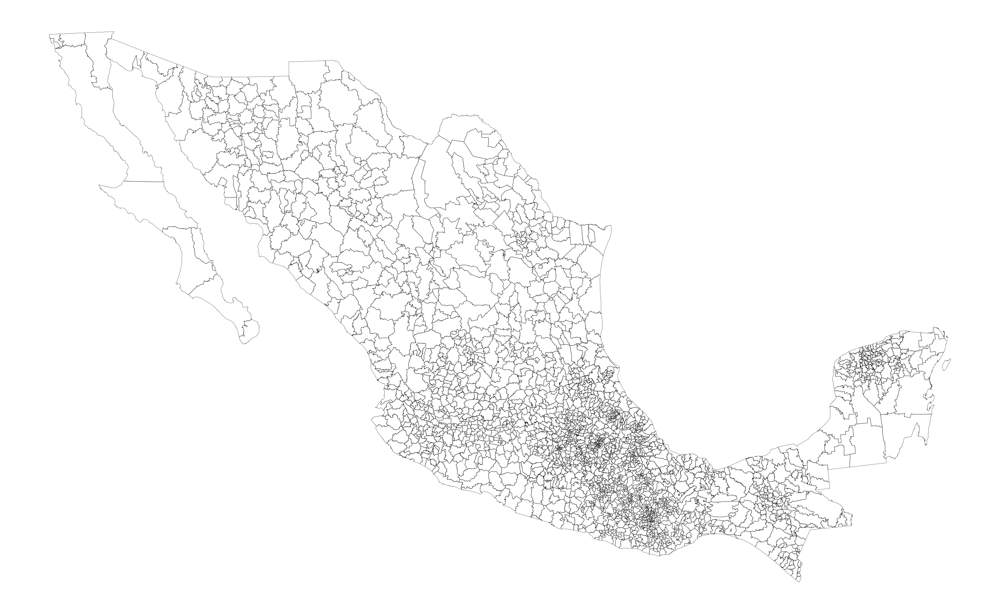

In [24]:
# Trazar el mapa en blanco con solo los polígonos de los estados
fig, ax = plt.subplots(figsize=(30, 30))  # Especifica un tamaño de figura más grande
mx.boundary.plot(ax=ax, linewidth=.3, color='black')  # Dibuja solo los límites de los polígonos
ax.set_axis_off()  # Desactiva los ejes para un mapa en "blanco"

plt.show()

## Mapa Coordenadas

#### Todas las Coordenadas

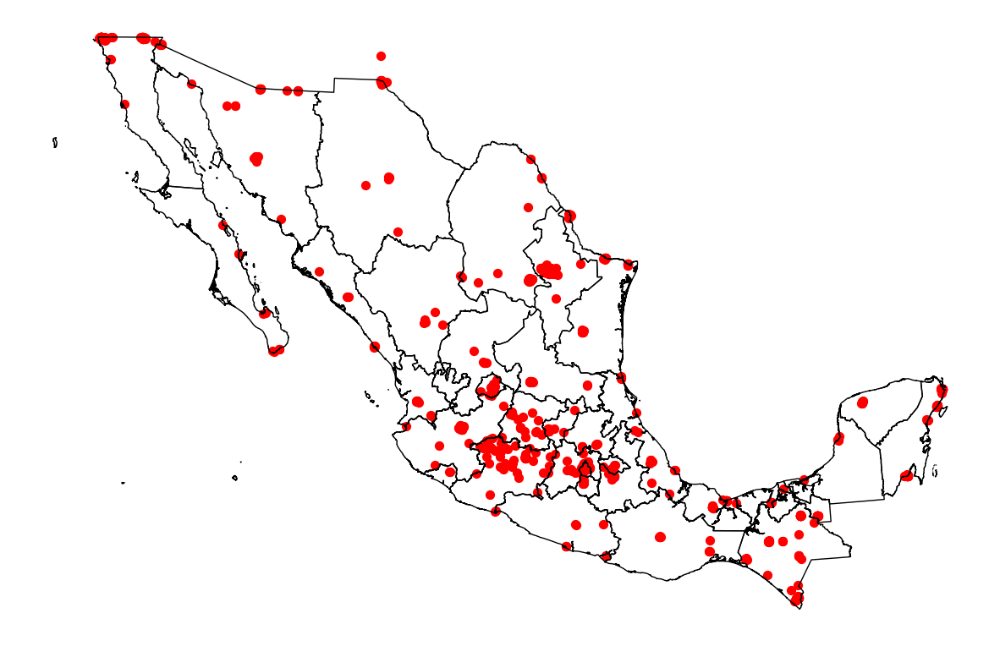

In [43]:
# Crea la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Trazar el mapa en blanco con solo los polígonos de los estados
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Trazar los puntos en el mapa
gdfinst.plot(ax=ax, markersize=50, color='red', marker='o', label='Punto')

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

plt.show()

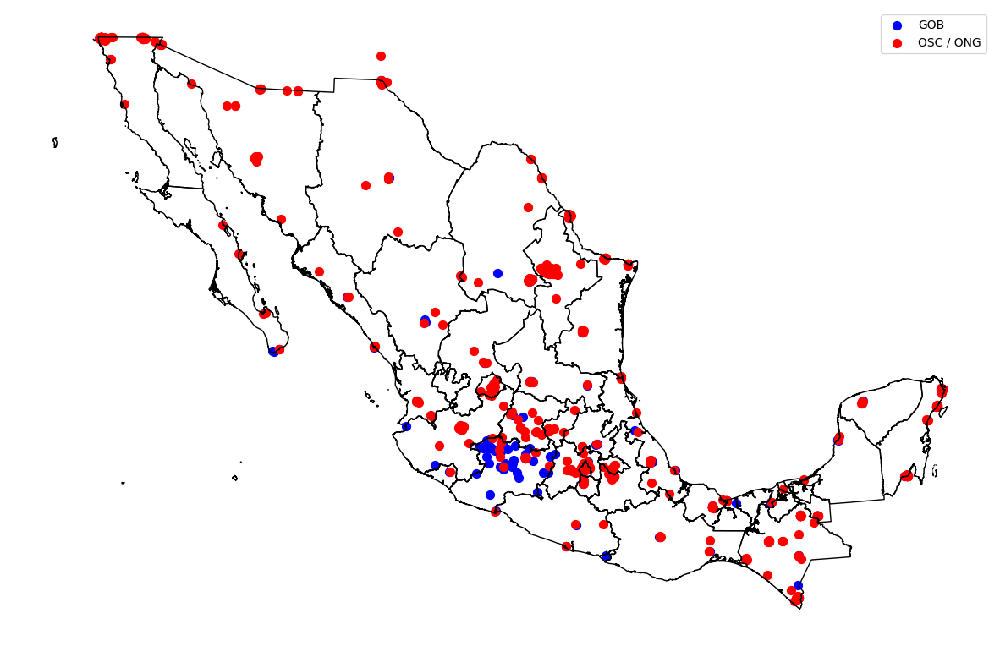

In [56]:
# Crear la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Trazar el mapa en blanco con solo los polígonos de los estados
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Trazar los puntos en el mapa según el 'tipo'
for tipo, color in color_dict.items():
    gdfinst[gdfinst['tipo'] == tipo].plot(ax=ax, markersize=50, color=color, marker='o', label=tipo)

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

# Agregar leyenda
ax.legend()

plt.show()

/Users/pablouriarte/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:695: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/Users/pablouriarte/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:695: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/Users/pablouriarte/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:695: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/Users/pablouriarte/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:695: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/Users/pablouriarte/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:695: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.w

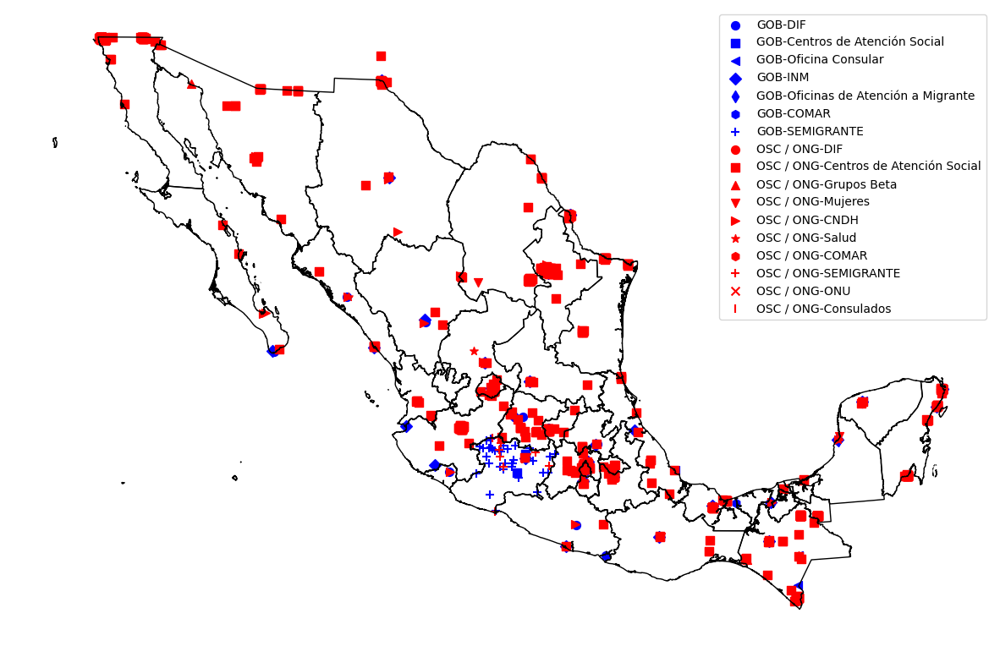

In [53]:
# Crear la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Trazar el mapa en blanco con solo los polígonos de los estados
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Trazar los puntos en el mapa según el 'tipo' y 'descripcion'
for tipo, color in color_dict.items():
    for desc, marker in marker_dict.items():
        subset = gdfinst[(gdfinst['tipo'] == tipo) & (gdfinst['descripcion'] == desc)]
        subset.plot(ax=ax, markersize=50, color=color, marker=marker, label=f"{tipo}-{desc}")

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

# Agregar leyenda
ax.legend()

plt.show()

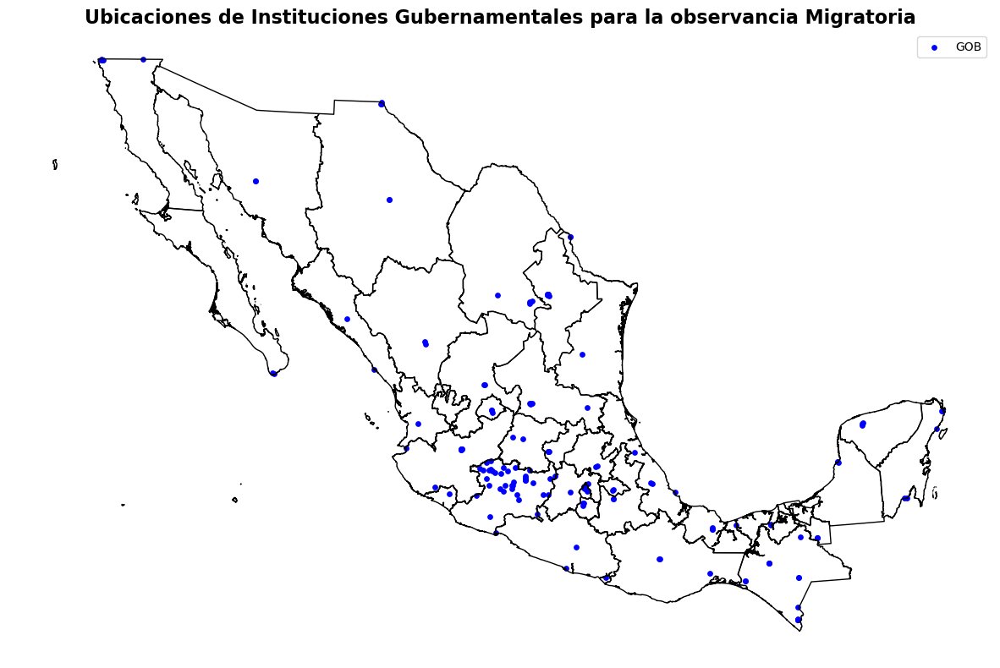

In [156]:
# Crear la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Agregar título al mapa
ax.set_title("Ubicaciones de Instituciones Gubernamentales para la observancia Migratoria", fontsize=16, fontweight='bold')

# Trazar el mapa en blanco con solo los polígonos de los estados
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Filtrar los datos para incluir solo los puntos de tipo 'GOB'
subset = gdfinst[gdfinst['tipo'] == 'GOB']

# Trazar los puntos en el mapa
subset.plot(ax=ax, markersize=15, color='blue', label='GOB')

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

# Agregar leyenda
ax.legend()

# Mostrar el mapa
plt.show()

## Mapa Coroplético

In [139]:
##Colores
# Crear una versión personalizada del mapa de colores 'Reds' que es menos oscura en el valor máximo
cmap = plt.cm.get_cmap('Reds', 256)  # Obtener el mapa de colores 'Reds' con 256 colores
newcolors = cmap(np.linspace(0, 0.65, 256))  # Utilizar solo el 56% del rango de colores
newcmap = ListedColormap(newcolors)  # Crear un nuevo mapa de colores


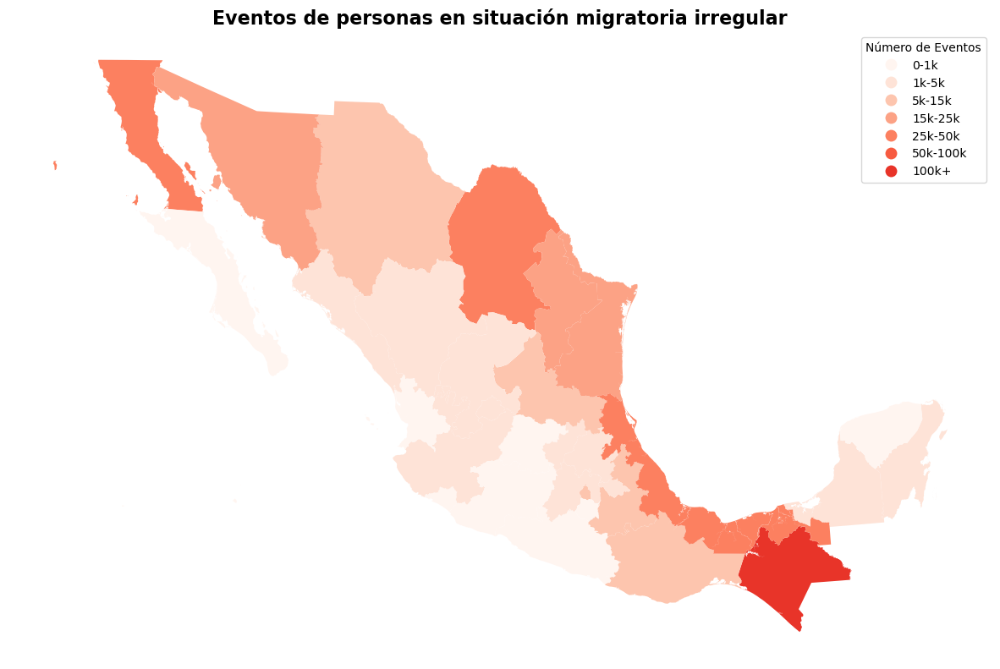

In [145]:
# 3.1 Eventos de personas en situación migratoria irregular en México, según entidad federativa, 2022
fig, ax = plt.subplots(figsize=(15, 15))

# Agregar título al mapa
ax.set_title("Eventos de personas en situación migratoria irregular", fontsize=16, fontweight='bold')

# Plot
merged_df.plot(
    column='Total_bins',
    cmap=newcmap,
    legend=True,
    legend_kwds={'title': 'Número de Eventos'},
    ax=ax
)

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

plt.show()

In [146]:
# se puede que la leyenda diga solo cuantos registros tiene cada estado?

# Mapa Contexto de la Migracion Irregular y presencia Institucional

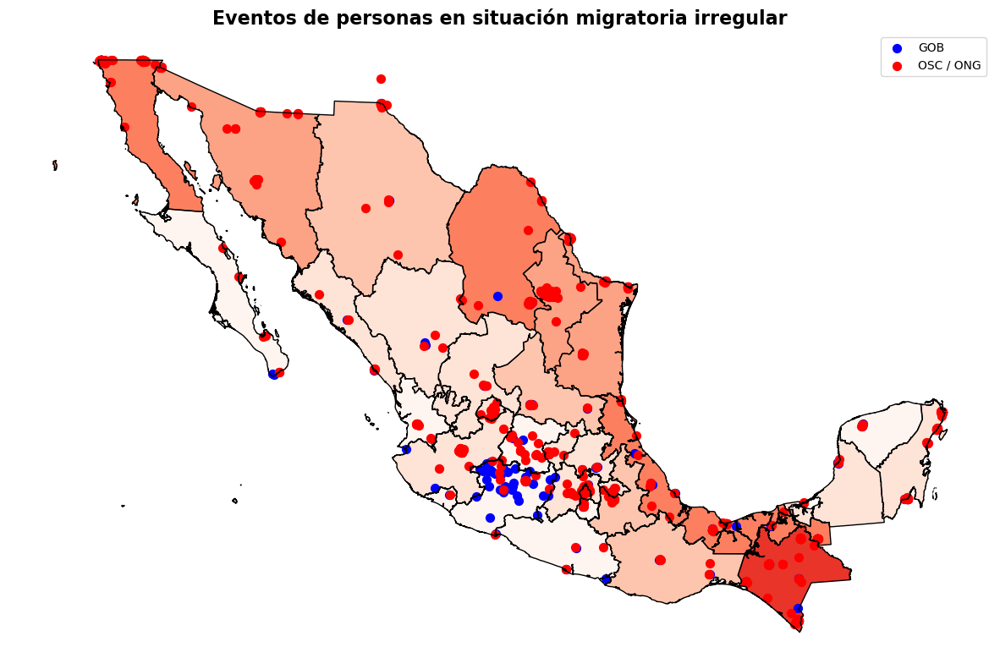

In [153]:
# Crear la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Agregar título al mapa
ax.set_title("Eventos de personas en situación migratoria irregular", fontsize=16, fontweight='bold')

# Primero, trazar el mapa de fondo con los polígonos de los estados
merged_df.plot(
    column='Total_bins',
    cmap=newcmap,
    legend=True,
    legend_kwds={'title': 'Número de Eventos'},
    ax=ax
)

# Luego, superponer los puntos en el mapa según el 'tipo'
for tipo, color in color_dict.items():
    gdfinst[gdfinst['tipo'] == tipo].plot(ax=ax, markersize=315, color=color, marker='o', label=tipo)

# Trazar el mapa en blanco con solo los polígonos de los estados (opcional)
# Si los bordes de los estados no son visibles, podemos trazar las fronteras en la parte superior.
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

# Agregar leyenda
ax.legend()

plt.show()

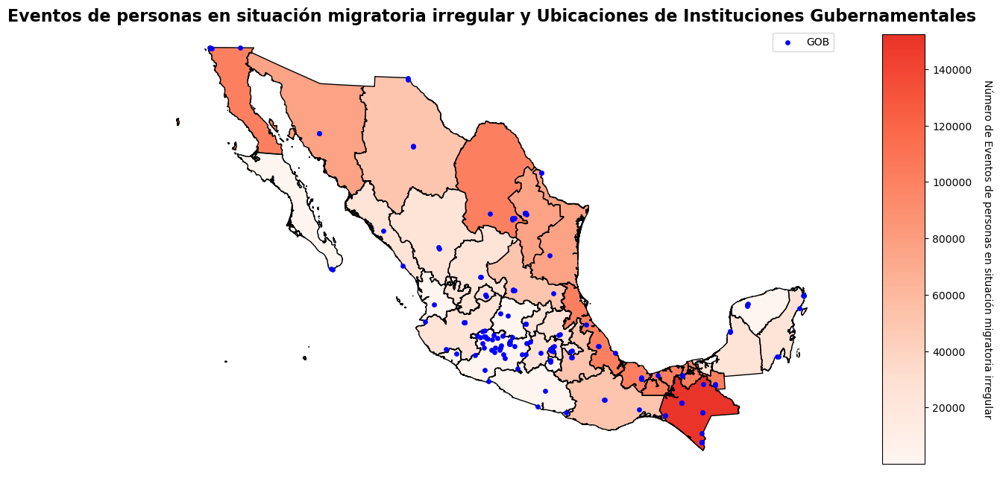

In [157]:
# Crear la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Agregar título al mapa
ax.set_title("Eventos de personas en situación migratoria irregular y Ubicaciones de Instituciones Gubernamentales", fontsize=16, fontweight='bold')

# Trazar el mapa en blanco con solo los polígonos de los estados
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Plot del mapa cloroplético
merged_df.plot(
    column='Total_bins',
    cmap=newcmap,
    legend=False,  # Desactivamos la leyenda aquí porque la añadiremos manualmente más tarde
    ax=ax
)

# Filtrar los datos para incluir solo los puntos de tipo 'GOB'
subset = gdfinst[gdfinst['tipo'] == 'GOB']

# Trazar los puntos en el mapa
subset.plot(ax=ax, markersize=15, color='blue', label='GOB', zorder=2)  # zorder=2 para que los puntos aparezcan por encima del mapa cloroplético

# Añadir manualmente la colorbar (leyenda de colores del cloropético)
sm = plt.cm.ScalarMappable(cmap=newcmap, norm=plt.Normalize(vmin=merged_df['Total'].min(), vmax=merged_df['Total'].max()))
sm.set_array([])  # solo para decirle a mpl qué rango usar
cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=0.5, aspect=10, pad=0.05)
cbar.set_label('Número de Eventos de personas en situación migratoria irregular', rotation=270, labelpad=20)

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

# Agregar leyenda
ax.legend()

# Mostrar el mapa
plt.show()


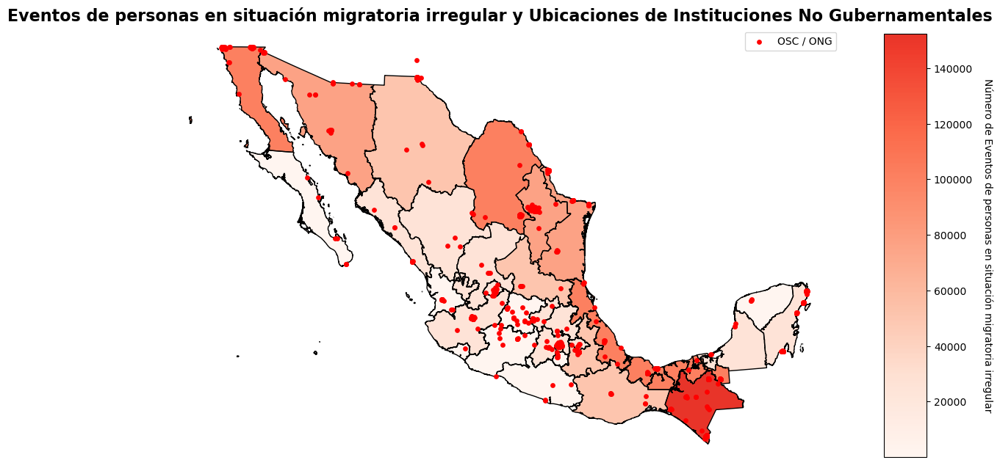

In [160]:
# Crear la figura y los ejes
fig, ax = plt.subplots(figsize=(15, 15))

# Agregar título al mapa
ax.set_title("Eventos de personas en situación migratoria irregular y Ubicaciones de Instituciones No Gubernamentales", fontsize=16, fontweight='bold')

# Trazar el mapa en blanco con solo los polígonos de los estados
mx1.boundary.plot(ax=ax, linewidth=1, color='black')

# Plot del mapa cloroplético
merged_df.plot(
    column='Total_bins',
    cmap=newcmap,
    legend=False,  # Desactivamos la leyenda aquí porque la añadiremos manualmente más tarde
    ax=ax
)

# Filtrar los datos para incluir solo los puntos de tipo 'GOB'
subset = gdfinst[gdfinst['tipo'] == 'OSC / ONG']

# Trazar los puntos en el mapa
subset.plot(ax=ax, markersize=15, color='red', label='OSC / ONG', zorder=2)  # zorder=2 para que los puntos aparezcan por encima del mapa cloroplético

# Añadir manualmente la colorbar (leyenda de colores del cloropético)
sm = plt.cm.ScalarMappable(cmap=newcmap, norm=plt.Normalize(vmin=merged_df['Total'].min(), vmax=merged_df['Total'].max()))
sm.set_array([])  # solo para decirle a mpl qué rango usar
cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=0.5, aspect=10, pad=0.05)
cbar.set_label('Número de Eventos de personas en situación migratoria irregular', rotation=270, labelpad=20)

# Desactiva los ejes para un mapa en "blanco"
ax.set_axis_off()

# Agregar leyenda
ax.legend()

# Mostrar el mapa
plt.show()

## Mapa: Rutas de la migracion.

/Users/pablouriarte/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


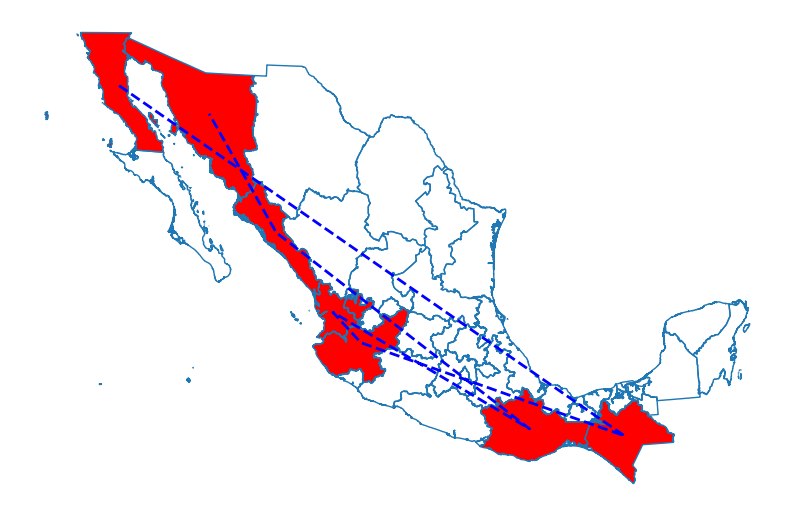

In [161]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import LineString

# Asumiendo que 'mx1' es tu GeoDataFrame con la geometría de los estados
# Filtrar los estados de interés
estados_interes = ['Chiapas', 'Oaxaca', 'Jalisco', 'Nayarit', 'Sinaloa', 'Sonora', 'Baja California']
filtro_estados = mx1[mx1['NOM_ENT'].isin(estados_interes)]

# Calcular los centroides de esos estados
filtro_estados['centroid'] = filtro_estados.geometry.centroid

# Crear una figura y un conjunto de ejes
fig, ax = plt.subplots(figsize=(10, 10))

# Trazar los límites de todos los estados
mx1.boundary.plot(ax=ax, linewidth=1)

# Trazar los centroides de los estados de interés
filtro_estados.plot(ax=ax, marker='o', color='red', markersize=50)

# Crear una línea que conecte los centroides
# Nota: Esto es un ejemplo simple que conecta los estados en el orden en que aparecen en el GeoDataFrame.
# Puedes cambiar el orden según lo necesites.
line = LineString(filtro_estados['centroid'].values)
gpd.GeoSeries([line]).plot(ax=ax, linewidth=2, linestyle='--', color='blue')

# Desactivar los ejes
ax.set_axis_off()

plt.show()


## OpenStreetMaps

Ya que pueda correr el mapa con rutas, coropletico y marcadores, intentar poner en un formato de mapa open streetmaps para mejorar las visualizaciones

In [162]:
import folium
import pandas as pd
import geopandas as gpd

# Crear una instancia de mapa de folium
m = folium.Map(location=[23.6345, -102.5528], zoom_start=5)  # Coordenadas para centrar el mapa en México

# Convertir el GeoDataFrame en GeoJSON
geojson_data = merged_df.to_json()

# Agregar la capa cloroplética al mapa
folium.Choropleth(
    geo_data=geojson_data,
    data=merged_df,
    columns=['CVEGEO', 'Total'],
    key_on='feature.properties.CVEGEO',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Número de Eventos'
).add_to(m)

# Agregar marcadores para instituciones
for idx, row in gdfinst.iterrows():
    if row['tipo'] == 'OSC / ONG':
        folium.Marker([row['geometry'].y, row['geometry'].x], popup=row['tipo']).add_to(m)

# Mostrar el mapa
m


/var/folders/68/6zkv8z4j4rl6ds90br2rb7ph0000gn/T/ipykernel_71684/3955271964.py:9: UserWarning: GeoDataFrame's CRS is not representable in URN OGC format. Resulting JSON will contain no CRS information.
  geojson_data = merged_df.to_json()
